# Import Librairie et Data

In [20]:
%load_ext autoreload
%autoreload 2

# Manipulation du dataframe
import pandas as pd 
import numpy as np

# Preprocessing
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import RobustScaler

from sklearn.pipeline import make_pipeline
from imblearn.pipeline import Pipeline as ImbPipeline

# Sampling
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler

# Métriques
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import make_scorer, roc_auc_score, roc_curve, fbeta_score

# Evaluation locale du modèle
import shap

# Modélisation
from lightgbm import LGBMClassifier
from sklearn.ensemble import RandomForestClassifier

# Optimisation modèle
from sklearn.model_selection import GridSearchCV, cross_val_score

# Sérialisation
import joblib

# MLOps
from mlflow.models.signature import infer_signature
from mlflow.pyfunc import PythonModel
import mlflow.sklearn

# Data drift
from evidently import ColumnMapping
from evidently.report import Report
from evidently.metric_preset import DataDriftPreset, ClassificationPreset, DataQualityPreset

# Fonctions personnalisées de pre-processing
import function_preprocessing as fp

import os

# scikit-learn version 1.4 car conflit avec UnderSampler : https://github.com/scikit-learn-contrib/imbalanced-learn/issues/1081#issuecomment-2127245933

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [47]:
# Importation du jeu de données joint et réduit des features sélectionnées.
df = pd.read_csv('./data/cleaned_df.csv', sep=';', encoding='utf-8')

# Dans le cadre de l'exercice et afin de réduire le temps d'exécution du grid_search
# on réduit la taille du dataframe à 20000 individus.
df = df.iloc[:20000, :]

print(f"Taille du dataframe {df.shape}")

# Initialisation de nos sets d'entraînement et de test.
X = df.drop(columns=['TARGET'])
y = df['TARGET']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=48)
print(f"Taille du jeu de train : {X_train.shape}")
print(f"Taille du jeu de test : {X_test.shape}")

Taille du dataframe (20000, 30)
Taille du jeu de train : (13400, 29)
Taille du jeu de test : (6600, 29)


In [3]:
"""
Ne pas oublier de lancer la commande pour intialiser un serveur local : 
mlflow server --host 127.0.0.1 --port 8080
"""

# Tracking du serveur local par MLFlow Tracking.
mlflow.set_tracking_uri(uri="http://127.0.0.1:8080")

In [4]:
# Initilisation de la pipeline avec ImbPipeline, nécessaire pour utiliser les différents samplers.
## Issu d'une version précédente, nous avons retenu le RandomUnderSampler comme meileur sampler.
pipeline_rf = ImbPipeline(
    steps=[
        ("imputer", SimpleImputer(strategy='median')),
        ("sampler", RandomUnderSampler()), 
        ("scaler", RobustScaler()),
        ("rfwrapper", fp.RFWrapper())
    ]
)
# Test des différents hyper paramètres de notre grid_search.
param_grid_rf = [
    {
        'rfwrapper__n_estimators':[100,500],
        'rfwrapper__max_depth':[None,3,5],
        'rfwrapper__min_samples_split':[50,80],
        'rfwrapper__min_samples_leaf':[None,2,5],
        'rfwrapper__threshold':np.arange(0.10,0.91,0.1)
    }
]

pipeline_lgbm = ImbPipeline(
    steps=[
        ("imputer", SimpleImputer(strategy='median')),
        ("sampler", RandomUnderSampler()), 
        ("scaler", RobustScaler()),
        ("lgbmwrapper", fp.LGBMWrapper())
    ]
)
param_grid_lgbm = [
    {
        'lgbmwrapper__n_estimators':[100,500],
        'lgbmwrapper__max_depth':[None,3,5],
        'lgbmwrapper__num_leaves':[3,5,7],
        'lgbmwrapper__min_child_samples':[25,50,100],
        'lgbmwrapper__threshold':np.arange(0.10,0.91,0.1)
    }
]
# Les deux scores retournés par le grid_search.
scorers = {
    'bank_scorer' : make_scorer(fp.bank_scoring, greater_is_better=True, cost_lost=-10, gain_win=1),
    'fbeta_score' : make_scorer(fbeta_score, beta=0.5)
}

# Modélisation

## Baseline

c:\Users\pierr\Documents\Cours\OpenClassroom\Projet_7\venv_p7\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\pierr\Documents\Cours\OpenClassroom\Projet_7\venv_p7\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\pierr\Documents\Cours\OpenClassroom\Projet_7\venv_p7\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  

Score de classification :
              precision    recall  f1-score   support

         0.0       0.92      1.00      0.96      6069
         1.0       0.00      0.00      0.00       531

    accuracy                           0.92      6600
   macro avg       0.46      0.50      0.48      6600
weighted avg       0.85      0.92      0.88      6600

Matrice de confusion :
[[6069    0]
 [ 531    0]]
Courbe ROC :



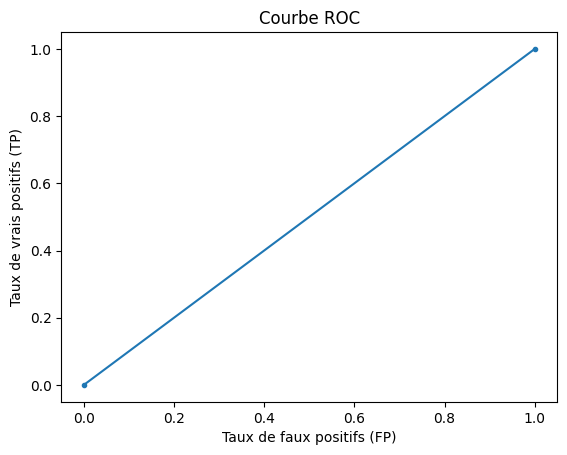

Score bancaire personnalisé : 1.4293785310734464
Fbeta score : 0.0


In [6]:
# Evaluation de notre modèle baseline qui prédit la classe la plus représentée.
y_pred = np.zeros(len(y_test))
fp.evaluation(y_test, y_pred)

print(f"Score bancaire personnalisé : {fp.bank_scoring(y_test=y_test, y_pred=y_pred)}")
print(f"Fbeta score : {fbeta_score(y_test, y_pred, beta=0.5)}")

## Random Forest

In [7]:
# Créer une expérimentation MLFlow
mlflow.set_experiment("Grid Search RF")

<Experiment: artifact_location='mlflow-artifacts:/380270376014729615', creation_time=1717345678433, experiment_id='380270376014729615', last_update_time=1717345678433, lifecycle_stage='active', name='Grid Search RF', tags={}>

In [8]:
# Entraînement du grid_search pour le Random Forest
grid_search_rf = GridSearchCV(
    estimator=pipeline_rf, 
    param_grid=param_grid_rf, 
    cv=5, 
    scoring=scorers,
    n_jobs=-1,
    refit='bank_scorer'
)

grid_search_rf.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('imputer',
                                        SimpleImputer(strategy='median')),
                                       ('sampler', RandomUnderSampler()),
                                       ('scaler', RobustScaler()),
                                       ('rfwrapper', RFWrapper())]),
             n_jobs=-1,
             param_grid=[{'rfwrapper__max_depth': [None, 3, 5],
                          'rfwrapper__min_samples_leaf': [None, 2, 5],
                          'rfwrapper__min_samples_split': [50, 80],
                          'rfwrapper__n_estimators': [100, 500],
                          'rfwrapper__threshold': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])}],
             refit='bank_scorer',
             scoring={'bank_scorer': make_scorer(bank_scoring, response_method='predict', cost_lost=-10, gain_win=1),
                      'fbeta_score': make_scorer(fbeta_score, response_method='predict', beta=0.5)})

In [9]:
# Obtenir les meilleurs paramètres.
best_params_rf = grid_search_rf.best_params_
print(f"Meilleurs paramètres : {best_params_rf}")

# Utiliser la pipeline avec les meilleurs paramètres.
best_pipeline_rf = grid_search_rf.best_estimator_
print(f"Meilleure pipeline : {best_pipeline_rf}")

# Affichage du score associé dans refit.
print(f"Meilleur score : {grid_search_rf.best_score_}")
print(f"FBeta Score du meilleur modèle : {grid_search_rf.cv_results_['mean_test_fbeta_score'][grid_search_rf.best_index_]}")

Meilleurs paramètres : {'rfwrapper__max_depth': 5, 'rfwrapper__min_samples_leaf': 5, 'rfwrapper__min_samples_split': 80, 'rfwrapper__n_estimators': 500, 'rfwrapper__threshold': 0.5}
Meilleur pipeline : Pipeline(steps=[('imputer', SimpleImputer(strategy='median')),
                ('sampler', RandomUnderSampler()), ('scaler', RobustScaler()),
                ('rfwrapper',
                 RFWrapper(max_depth=5, min_samples_leaf=5,
                           min_samples_split=80, n_estimators=500))])
Meilleur score : 4.8168180453023
FBeta Score du meilleur modèle : 0.18136254654388498


Score de classification :
              precision    recall  f1-score   support

         0.0       0.96      0.67      0.79      6069
         1.0       0.16      0.69      0.25       531

    accuracy                           0.67      6600
   macro avg       0.56      0.68      0.52      6600
weighted avg       0.90      0.67      0.75      6600

Matrice de confusion :
[[4068 2001]
 [ 162  369]]
Courbe ROC :



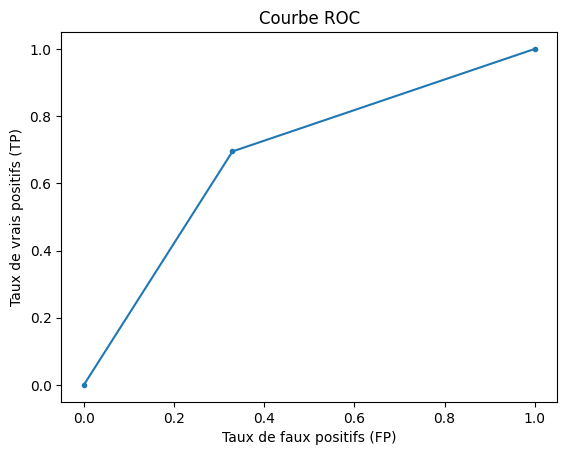

In [10]:
# Evaluation du modèle de Random Forest.
y_pred_rf = best_pipeline_rf.predict(X_test)
fp.evaluation(y_test, y_pred_rf)

In [11]:
# Print des retours des modèles du grid_search.
resultats_cv_rf = pd.DataFrame(grid_search_rf.cv_results_)
resultats_cv_rf[['rank_test_bank_scorer','mean_test_bank_scorer','mean_test_fbeta_score','mean_fit_time','params']]

,rank_test_bank_scorer,mean_test_bank_scorer,mean_test_fbeta_score,mean_fit_time,params
0,324,0.041057,0.096084,1.284369,"{'rfwrapper__max_depth': None, 'rfwrapper__min..."
1,286,0.695768,0.100958,1.209372,"{'rfwrapper__max_depth': None, 'rfwrapper__min..."
2,150,2.389283,0.117427,1.098484,"{'rfwrapper__max_depth': None, 'rfwrapper__min..."
3,87,3.851439,0.141537,1.126989,"{'rfwrapper__max_depth': None, 'rfwrapper__min..."
4,29,4.615044,0.176337,1.129432,"{'rfwrapper__max_depth': None, 'rfwrapper__min..."
...,...,...,...,...,...
319,1,4.816818,0.181363,1.071928,"{'rfwrapper__max_depth': 5, 'rfwrapper__min_sa..."
320,44,4.501249,0.227333,1.007432,"{'rfwrapper__max_depth': 5, 'rfwrapper__min_sa..."
321,134,3.439283,0.264358,1.045317,"{'rfwrapper__max_depth': 5, 'rfwrapper__min_sa..."
322,188,2.270387,0.165514,1.037929,"{'rfwrapper__max_depth': 5, 'rfwrapper__min_sa..."


In [13]:
with mlflow.start_run() as run:
    mlflow.log_params(best_params_rf)

    mlflow.log_metrics({
        "bank scorer" : grid_search_rf.best_score_,
        "fbeta score" : grid_search_rf.cv_results_['mean_test_fbeta_score'][grid_search_rf.best_index_]
    })

    mlflow.set_tag("Training", "Random Forest", "optimisation")

    signature = infer_signature(X_train, best_pipeline_rf.predict(X_train))
    
    model_info = mlflow.sklearn.log_model(
        sk_model=best_pipeline_rf,
        artifact_path="modelisation",
        signature=signature,
        input_example=X_train,
        registered_model_name="tracking_hyper_param_rf",
    )

c:\Users\pierr\Documents\Cours\OpenClassroom\Projet_7\venv_p7\lib\site-packages\mlflow\types\utils.py:394: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(
Registered model 'tracking_hyper_param_rf' already exists. Creating a new version of this model...
2024/06/09 09:04:32 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model vers

In [14]:
joblib.dump(best_pipeline_rf, "pipeline_scoring_rf.joblib")
artifacts_rf = {"model_path": "C:/Users/pierr/Documents/Cours/OpenClassroom/Projet_7/mlartifacts/380270376014729615/09925820535b4d709ed65df3dcf135a5/artifacts/modelisation"}

# Define the signature associated with the model
signature_rf = infer_signature(X_train, params={"predict_method": "predict_proba"})

c:\Users\pierr\Documents\Cours\OpenClassroom\Projet_7\venv_p7\lib\site-packages\mlflow\types\utils.py:394: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(


In [15]:
with mlflow.start_run() as run:
    mlflow.pyfunc.save_model(
        path='modelisation_rf',
        python_model=fp.PredictProbaWrapper(),
        input_example=X_train,
        signature=signature_rf,
        artifacts=artifacts_rf,
        pip_requirements=["joblib", "scikit-learn==1.4.2", "lightgbm", "imblearn"],
    )

c:\Users\pierr\Documents\Cours\OpenClassroom\Projet_7\venv_p7\lib\site-packages\_distutils_hack\__init__.py:18: UserWarning: Distutils was imported before Setuptools, but importing Setuptools also replaces the `distutils` module in `sys.modules`. This may lead to undesirable behaviors or errors. To avoid these issues, avoid using distutils directly, ensure that setuptools is installed in the traditional way (e.g. not an editable install), and/or make sure that setuptools is always imported before distutils.
  warnings.warn(
c:\Users\pierr\Documents\Cours\OpenClassroom\Projet_7\venv_p7\lib\site-packages\_distutils_hack\__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")


In [ ]:
"""explainer_rf = shap.Explainer(best_pipeline_rf.predict, X_train)
shap_values_rf = explainer_rf(X)

joblib.dump(shap_values_rf, 'shap_values_rf.joblib')"""

## LGBM

In [5]:
# Créer une expérimentation MLFlow
mlflow.set_experiment("Grid Search LGBM")

<Experiment: artifact_location='mlflow-artifacts:/244259207142630421', creation_time=1717921848654, experiment_id='244259207142630421', last_update_time=1717921848654, lifecycle_stage='active', name='Grid Search LGBM', tags={}>

In [6]:
grid_search_lgbm = GridSearchCV(
    estimator=pipeline_lgbm, 
    param_grid=param_grid_lgbm, 
    cv=5, 
    scoring=scorers,
    n_jobs=-1,
    refit='bank_scorer'
)

grid_search_lgbm.fit(X_train, y_train)

[LightGBM] [Info] Number of positive: 1047, number of negative: 1047
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000617 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6319
[LightGBM] [Info] Number of data points in the train set: 2094, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('imputer',
                                        SimpleImputer(strategy='median')),
                                       ('sampler', RandomUnderSampler()),
                                       ('scaler', RobustScaler()),
                                       ('lgbmwrapper', LGBMWrapper())]),
             n_jobs=-1,
             param_grid=[{'lgbmwrapper__max_depth': [None, 3, 5],
                          'lgbmwrapper__min_child_samples': [25, 50, 100],
                          'lgbmwrapper__n_estimators': [100, 500],
                          'lgbmwrapper__num_leaves': [3, 5, 7],
                          'lgbmwrapper__threshold': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])}],
             refit='bank_scorer',
             scoring={'bank_scorer': make_scorer(bank_scoring, response_method='predict', cost_lost=-10, gain_win=1),
                      'fbeta_score': make_scorer(fbeta_score, response_method='predict', beta=0.5)})

In [7]:
# Obtenir les meilleurs paramètres.
best_params_lgbm = grid_search_lgbm.best_params_
print(f"Meilleurs paramètres : {best_params_lgbm}")

# Utiliser la pipeline avec les meilleurs paramètres.
best_pipeline_lgbm = grid_search_lgbm.best_estimator_
print(f"Meilleur pipeline : {best_pipeline_lgbm}")

# Affichage du score associé dans refit.
print(f"Meilleur score : {grid_search_lgbm.best_score_}")
print(f"FBeta Score du meilleur modèle : {grid_search_lgbm.cv_results_['mean_test_fbeta_score'][grid_search_lgbm.best_index_]}")

Meilleurs paramètres : {'lgbmwrapper__max_depth': 5, 'lgbmwrapper__min_child_samples': 25, 'lgbmwrapper__n_estimators': 100, 'lgbmwrapper__num_leaves': 7, 'lgbmwrapper__threshold': 0.6}
Meilleur pipeline : Pipeline(steps=[('imputer', SimpleImputer(strategy='median')),
                ('sampler', RandomUnderSampler()), ('scaler', RobustScaler()),
                ('lgbmwrapper',
                 LGBMWrapper(max_depth=5, min_child_samples=25, num_leaves=7,
                             threshold=0.6))])
Meilleur score : 4.923618555626933
FBeta Score du meilleur modèle : 0.20024512433806113


Score de classification :
              precision    recall  f1-score   support

         0.0       0.96      0.76      0.85      6069
         1.0       0.18      0.60      0.28       531

    accuracy                           0.75      6600
   macro avg       0.57      0.68      0.56      6600
weighted avg       0.89      0.75      0.80      6600

Matrice de confusion :
[[4642 1427]
 [ 214  317]]
Courbe ROC :



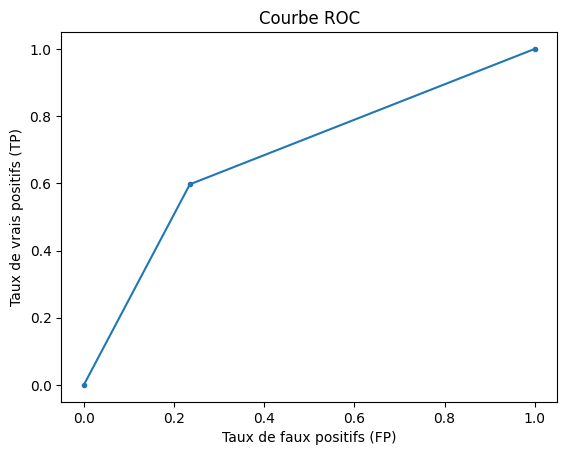

In [8]:
# Evaluation du modèle de Light GBM.
y_pred_lgbm = best_pipeline_lgbm.predict(X_test)
fp.evaluation(y_test, y_pred_lgbm)

In [9]:
# Print des retours des modèles du grid_search.
resultats_cv_lgbm = pd.DataFrame(grid_search_lgbm.cv_results_)
resultats_cv_lgbm[['rank_test_bank_scorer','mean_test_bank_scorer','mean_test_fbeta_score','mean_fit_time','params']]

,rank_test_bank_scorer,mean_test_bank_scorer,mean_test_fbeta_score,mean_fit_time,params
0,444,1.624743,0.109317,1.947298,"{'lgbmwrapper__max_depth': None, 'lgbmwrapper_..."
1,416,2.874170,0.123820,1.749320,"{'lgbmwrapper__max_depth': None, 'lgbmwrapper_..."
2,294,3.747598,0.139122,1.121158,"{'lgbmwrapper__max_depth': None, 'lgbmwrapper_..."
3,177,4.296679,0.155540,1.315120,"{'lgbmwrapper__max_depth': None, 'lgbmwrapper_..."
4,142,4.417540,0.168610,1.394932,"{'lgbmwrapper__max_depth': None, 'lgbmwrapper_..."
...,...,...,...,...,...
481,54,4.593352,0.174086,0.976994,"{'lgbmwrapper__max_depth': 5, 'lgbmwrapper__mi..."
482,60,4.583227,0.190608,0.964344,"{'lgbmwrapper__max_depth': 5, 'lgbmwrapper__mi..."
483,109,4.504759,0.219692,0.986388,"{'lgbmwrapper__max_depth': 5, 'lgbmwrapper__mi..."
484,215,4.146334,0.253727,0.934002,"{'lgbmwrapper__max_depth': 5, 'lgbmwrapper__mi..."


In [10]:
with mlflow.start_run():
    mlflow.log_params(best_params_lgbm)

    mlflow.log_metrics({
        "bank scorer" : grid_search_lgbm.best_score_,
        "fbeta score" : grid_search_lgbm.cv_results_['mean_test_fbeta_score'][grid_search_lgbm.best_index_]
    })

    mlflow.set_tag("Training", "Light GBM", "optimisation")

    signature_lgbm = infer_signature(X_train, best_pipeline_lgbm.predict(X_train))

    model_info = mlflow.sklearn.log_model(
        sk_model=best_pipeline_lgbm,
        artifact_path="modelisation",
        signature=signature_lgbm,
        input_example=X_train,
        registered_model_name="tracking-hyper-param_lgbm",
    )

c:\Users\pierr\Documents\Cours\OpenClassroom\Projet_7\venv_p7\lib\site-packages\mlflow\types\utils.py:394: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(
Registered model 'tracking-hyper-param_lgbm' already exists. Creating a new version of this model...
2024/07/17 14:43:55 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model ve

In [11]:
joblib.dump(best_pipeline_lgbm, "pipeline_scoring_lgbm.joblib")
artifacts_lgbm = {"model_path": "C:/Users/pierr/Documents/Cours/OpenClassroom/Projet_7/mlartifacts/380270376014729615/22966543f9c04f5495398fca38b46ceb/artifacts/modelisation"}

signature_lgbm = infer_signature(X_train, params={"predict_method": "predict_proba"})

c:\Users\pierr\Documents\Cours\OpenClassroom\Projet_7\venv_p7\lib\site-packages\mlflow\types\utils.py:394: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(


In [ ]:
with mlflow.start_run() as run:
    mlflow.pyfunc.save_model(
        path='modelisation_lgbm',
        python_model=fp.PredictProbaWrapper(),
        input_example=X_train,
        signature=signature_lgbm,
        artifacts=artifacts_lgbm,
        pip_requirements=["joblib", "scikit-learn==1.4.2", "lightgbm", "imblearn"],
    )

In [22]:
explainer_lgbm = shap.Explainer(best_pipeline_lgbm.predict, X_train)
shap_values_lgbm = explainer_lgbm(X)

PermutationExplainer explainer: 20001it [1:07:37,  4.92it/s]                           


In [23]:
joblib.dump(shap_values_lgbm, 'shap_values_lgbm.joblib')

['shap_values_lgbm.joblib']

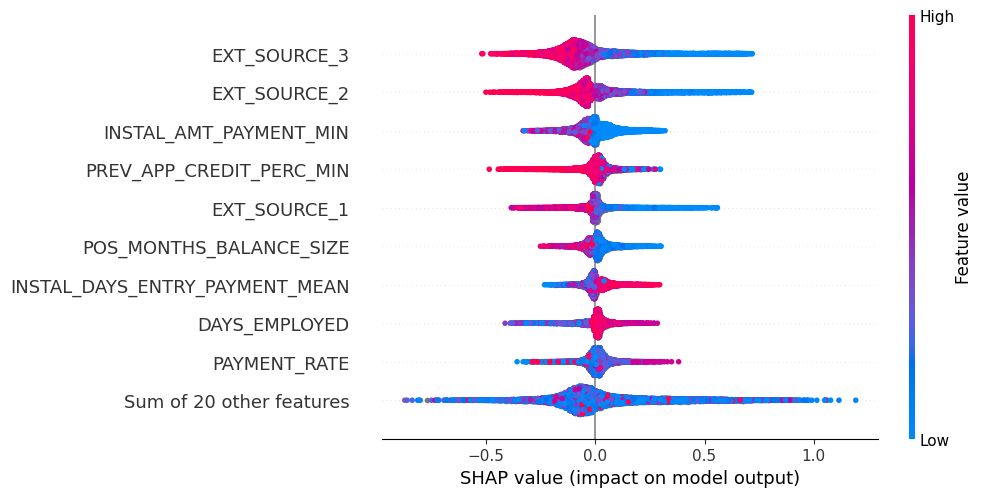

In [24]:
shap.plots.beeswarm(shap_values_lgbm)

In [ ]:
"""
# Sous Windows, activer le mode développeur.
mlflow models serve -m modelisation_lgbm/
curl http://127.0.0.1:5000/invocations -H 'Content-Type: application/json' -d '{"data:[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]]}'  
"""

# Data Drift

In [48]:
best_pipeline = joblib.load("pipeline_scoring_lgbm.joblib")

In [49]:
# Création d'un dataframe représentant nos données actuelles
df_old = df.copy()

# et d'un dataframe présentant des données nouvelles pour le modèle.
df_new = pd.read_csv('./data/cleaned_df.csv', sep=';', encoding='utf-8')
df_new = df_new.iloc[20000:40000,:]
# reset_index sinon la colonne de prediction est NaN
df_new = df_new.reset_index(drop=True)

In [50]:
# Calcul des prédictions
old_prediction = best_pipeline.predict_proba(df_old.drop(columns=['TARGET']))
## Convertit prediction en dataframe car l'output modèle est une array de liste
## ensuite on ne prend que la première colonne pour le risque d'insolvabilité.
df_old['prediction'] = pd.DataFrame(old_prediction)[0]
df_old['TARGET'] = df_old['TARGET'].astype(int)

new_prediction = best_pipeline.predict_proba(df_new.drop(columns=['TARGET']))
df_new['prediction'] = pd.DataFrame(new_prediction)[0]
df_new['TARGET'] = df_new['TARGET'].astype(int)

In [51]:
# Mapping evidently pour respecter la structure d'evidently
column_mapping = ColumnMapping()

column_mapping.target = 'TARGET'
column_mapping.prediction = 'prediction'
column_mapping.numerical_features = list(X.columns)

In [52]:
data_drift = Report(metrics=[DataDriftPreset(), ClassificationPreset(probas_threshold=0.6)])
data_drift.run(current_data=df_old, reference_data=df_new, column_mapping=column_mapping)
data_drift.show()

In [53]:
data_quality = Report(metrics=[DataQualityPreset()])
data_quality.run(current_data=df_old, reference_data=df_new, column_mapping=column_mapping)
data_quality.show()

In [54]:
data_drift.save_html("analyse_data_drift.html")

Afin de tester le data drift, on essaye sur un autre jeu de données "application_test" et "application_train" qui traduisent peut-être un plus grand écart dans le temps et de tester le risque de data drift.

In [40]:
application_test = pd.read_csv("data/application_test.csv", sep=",", encoding="utf-8")
application_test = application_test.drop(columns=["SK_ID_CURR"])
application_train = pd.read_csv("data/application_train.csv", sep=",", encoding="utf-8")
application_train = application_train.drop(columns=["SK_ID_CURR", "TARGET"])

In [41]:
application_train.dtypes

NAME_CONTRACT_TYPE             object
CODE_GENDER                    object
FLAG_OWN_CAR                   object
FLAG_OWN_REALTY                object
CNT_CHILDREN                    int64
                               ...   
AMT_REQ_CREDIT_BUREAU_DAY     float64
AMT_REQ_CREDIT_BUREAU_WEEK    float64
AMT_REQ_CREDIT_BUREAU_MON     float64
AMT_REQ_CREDIT_BUREAU_QRT     float64
AMT_REQ_CREDIT_BUREAU_YEAR    float64
Length: 120, dtype: object

In [42]:
column_mapping = ColumnMapping()
column_mapping.numerical_features = application_train.select_dtypes(exclude=['object']).columns.tolist()
column_mapping.categorical_features = application_train.select_dtypes(include=['object']).columns.tolist()

In [44]:
report = Report(metrics=[DataDriftPreset()])
report.run(column_mapping = column_mapping, reference_data=application_train, current_data=application_test)

In [45]:
report.show()

In [46]:
report.save_html("analyse_data_drift_2.html")